# Analysis of NYC public schools results in ELA and math grades 3-8.

<span style="color: red;">**If kernel can't connect to server again run command:**
*netsh winsock reset*<span>

<a id="TOC"></a> 
## Table of Contents
1. [Data sources and definitions](#data)
2. [Imports: modules](#modules)
3. [Read and prepare data](#read)
4. [Best middle schools by math](#best)
5. [Maps of middle schools by math results](#maps) 


<a id="data"></a> 
#### Data:
1. Data New York City grades 3-8 New York State English Language Arts and Math State Tests results 2013-2023:<br>https://infohub.nyced.org/reports/academics/test-results
2. NYS schools locations:<br>
https://data.gis.ny.gov/maps/b6c624c740e4476689aa60fdc4aacb8f/about
3. Citywide or Boroughwide status:
<br>https://www.nycschoolhelp.com/borowide-citywide-middle-schools

#### Definitions of Performance Levels for the 2023 Grades 3-8 English Language Arts and Mathematics Tests  

**NYS Level 1**: Students performing at this level are below proficient in standards for their grade. They may demonstrate limited knowledge, skills, and practices embodied by the Learning Standards that are considered insufficient for the expectations at this grade. 

**NYS Level 2**: Students performing at this level are partially proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered partial but insufficient for the expectations at this grade. Students performing at Level 2 are considered on track to meet current New York high school graduation requirements but are not yet proficient in Learning Standards at this grade. 

**NYS Level 3**: Students performing at this level are proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered sufficient for the expectations at this grade.  

**NYS Level 4**: Students performing at this level excel in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered more than sufficient for the expectations at this grade.  

*Source: NYSED, 2023, https://www.p12.nysed.gov/irs/ela-math/2023/ela-math-score-ranges-performance-levels-2023.pdf*

## Questions
*1. How the test results changed?*
<br>Compare last year test results in a school with the school 10-year average as percentage of average:
<br> school_change = school_current_year - school_10year_average
<br> citywide_change = average of school_change over schools
<br> relative_school_change = school_change - citywide_change
<br>
*2. How good the school is?* 
<br>Last three testing period results (2019, 2022, 2023) are different for some schools: due to COVID disruptions, testing procedures changes, in Destrict 15 due to admission rules changed. Therefore average 10 years scores do not reflect well schools situation now. Results for these 3 last testing years are teken instead.
<br>
*3. Is the school citywide or borowide?*
<br>
*


<a id="modules"></a> 
#### Imports: modules

In [23]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from shapely.geometry import Point
import difflib
from fuzzywuzzy import process
import fuzzywuzzy
import base64
from io import BytesIO
import math
from tqdm import tqdm

pd.set_option('display.float_format', '{:.3f}'.format)

<a id="read"></a> 
#### Read data

In [2]:
basePath = r"G:\My Drive\Kids\NYC_schools"
dataFolder = r"raw_data"
outputFolder = r"processed_data"

#Read math results
fileName_math = "school-math-results-2013-2023-(public).xlsx"
mathPath = os.path.join(basePath,dataFolder,fileName_math)
print(mathPath)
sheetName_math = "All"
mathResultsDF = pd.read_excel(mathPath, sheetName_math)

#Read ELA results
fileName_ELA = "school-ela-results-2013-2023-(public).xlsx"
ELAPath = os.path.join(basePath, dataFolder, fileName_ELA)
print(ELAPath)
sheetName_ELA = "All"
ELAResultsDF = pd.read_excel(ELAPath, sheetName_ELA)

#Read demographic file
fileName_demog = "demographic-snapshot-2018-19-to-2022-23-(public).xlsx"
demogPath = os.path.join(basePath, dataFolder, fileName_demog)
print(demogPath)
sheetName_demog = "School"
demogData = pd.read_excel(demogPath, sheetName_demog)

G:\My Drive\Kids\NYC_schools\raw_data\school-math-results-2013-2023-(public).xlsx
G:\My Drive\Kids\NYC_schools\raw_data\school-ela-results-2013-2023-(public).xlsx
G:\My Drive\Kids\NYC_schools\raw_data\demographic-snapshot-2018-19-to-2022-23-(public).xlsx


In [3]:
subjects = ['Math', 'ELA']
resultsDFs = {'Math': mathResultsDF, 'ELA': ELAResultsDF}

In [4]:
# resultsDF.info() showed that most of the columns are objects instead of numbers and needed to be converted
for subject in subjects:
    resultsDF = resultsDFs[subject]
    resultsDF_colToConvert = ['Mean Scale Score',
     'Grade',                             
     '# Level 1',
     '% Level 1',
     '# Level 2',
     '% Level 2',
     '# Level 3',
     '% Level 3',
     '# Level 4',
     '% Level 4',
     '# Level 3+4',
     '% Level 3+4']
    resultsDF[resultsDF_colToConvert] = resultsDF[resultsDF_colToConvert].apply(pd.to_numeric, errors = 'coerce')
    resultsDF.info()
    
del resultsDF

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41918 entries, 0 to 41917
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DBN               41918 non-null  object 
 1   School Name       41918 non-null  object 
 2   Grade             32173 non-null  float64
 3   Year              41918 non-null  int64  
 4   Category          41918 non-null  object 
 5   Number Tested     41918 non-null  int64  
 6   Mean Scale Score  41559 non-null  float64
 7   # Level 1         41559 non-null  float64
 8   % Level 1         41559 non-null  float64
 9   # Level 2         41559 non-null  float64
 10  % Level 2         41559 non-null  float64
 11  # Level 3         41559 non-null  float64
 12  % Level 3         41559 non-null  float64
 13  # Level 4         41559 non-null  float64
 14  % Level 4         41559 non-null  float64
 15  # Level 3+4       41559 non-null  float64
 16  % Level 3+4       41559 non-null  float6

## Analysis

#### Prepare dataframe with only middle school results (grades 6-8)

In [5]:
resultsMS_bySchl_Norm ={}

for subject in subjects:
    
    
    resultsDF = resultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by years
    resultsMS_bySchl = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)]
    resultsMS_bySchl = resultsMS_bySchl.groupby(['DBN', 'School Name', 'Year'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    
    # Change column names to include subject
    resultsMS_bySchl.columns = [f'Level 1 {subject}',f'Level 2 {subject}',f'Level 3 {subject}',f'Level 4 {subject}']
    
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_Norm[subject] = resultsMS_bySchl.div(resultsMS_bySchl.sum(axis=1), axis=0)
    resultsMS_bySchl_Norm[subject].reset_index(inplace=True)
    
    print(resultsMS_bySchl_Norm[subject].head(50))
    
del resultsDF, resultsMS_bySchl

       DBN                            School Name  Year  Level 1 Math  \
0   01M015              P.S. 015 ROBERTO CLEMENTE  2023           NaN   
1   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2013         0.302   
2   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2014         0.336   
3   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2015         0.361   
4   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2016         0.420   
5   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2017         0.412   
6   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2018         0.580   
7   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2019         0.524   
8   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2022         0.738   
9   01M034         P.S. 034 FRANKLIN D. ROOSEVELT  2023         0.366   
10  01M140                 P.S. 140 NATHAN STRAUS  2013         0.555   
11  01M140                 P.S. 140 NATHAN STRAUS  2014         0.489   
12  01M140                 P.S. 140 NATHAN STRAUS  

In [6]:
# Make a merged dataframe with both Math and ELA results
DFs = list(resultsMS_bySchl_Norm.values())
allResultsDF = pd.merge(DFs[0], DFs[1], on = ['DBN', 'Year'], how = 'inner')
allResultsDF.head(5)

,DBN,School Name_x,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA
0,01M015,P.S. 015 ROBERTO CLEMENTE,2023,NaN,NaN,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2013,0.302,0.416,0.195,0.087,P.S. 034 FRANKLIN D. ROOSEVELT,0.366,0.524,0.097,0.014
2,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2014,0.336,0.375,0.230,0.059,P.S. 034 FRANKLIN D. ROOSEVELT,0.301,0.477,0.176,0.046
3,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2015,0.361,0.392,0.190,0.057,P.S. 034 FRANKLIN D. ROOSEVELT,0.250,0.461,0.250,0.039
4,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2016,0.420,0.408,0.127,0.045,P.S. 034 FRANKLIN D. ROOSEVELT,0.237,0.481,0.231,0.051


In [7]:
# Add colomn with sum of shares of level4 students by Math and level4 students ELa
allResultsDF['Level 4 Math+Ela'] = allResultsDF[f'Level 4 {subjects[0]}']+allResultsDF[f'Level 4 {subjects[1]}']
allResultsDF.head(10)

,DBN,School Name_x,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,2023,NaN,NaN,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2013,0.302,0.416,0.195,0.087,P.S. 034 FRANKLIN D. ROOSEVELT,0.366,0.524,0.097,0.014,0.101
2,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2014,0.336,0.375,0.230,0.059,P.S. 034 FRANKLIN D. ROOSEVELT,0.301,0.477,0.176,0.046,0.105
3,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2015,0.361,0.392,0.190,0.057,P.S. 034 FRANKLIN D. ROOSEVELT,0.250,0.461,0.250,0.039,0.096
4,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2016,0.420,0.408,0.127,0.045,P.S. 034 FRANKLIN D. ROOSEVELT,0.237,0.481,0.231,0.051,0.096
5,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2017,0.412,0.420,0.137,0.031,P.S. 034 FRANKLIN D. ROOSEVELT,0.187,0.511,0.245,0.058,0.088
6,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2018,0.580,0.277,0.092,0.050,P.S. 034 FRANKLIN D. ROOSEVELT,0.284,0.414,0.172,0.129,0.180
7,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2019,0.524,0.311,0.146,0.019,P.S. 034 FRANKLIN D. ROOSEVELT,0.393,0.402,0.121,0.084,0.104
8,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2022,0.738,0.154,0.092,0.015,P.S. 034 FRANKLIN D. ROOSEVELT,0.337,0.421,0.147,0.095,0.110
9,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2023,0.366,0.366,0.220,0.049,P.S. 034 FRANKLIN D. ROOSEVELT,0.241,0.430,0.241,0.089,0.137


#### Select schools with the best results for all middle school grades in 2023

In [29]:
# Select best schools by subjects
for subject in subjects:
    
    resultsMS_bySchl_sorted = resultsMS_bySchl_Norm[subject].sort_values(by = ['Year', f'Level 4 {subject}'], ascending=[False, False])
    print(resultsMS_bySchl_sorted.head(50))

    #resultsMS_bySchl_sorted.head(50).to_csv(f'50_schools_with_highest_level4_share_{subject}2023.csv', index = True)
    
del resultsMS_bySchl_sorted

         DBN                                        School Name  Year  \
413   03M334                                THE ANDERSON SCHOOL  2023   
72    01M539  NEW EXPLORATIONS INTO SCIENCE, TECHNOLOGY AND ...  2023   
440   03M859                               SPECIAL MUSIC SCHOOL  2023   
2736  21K098                                I.S. 98 BAY ACADEMY  2023   
2628  20K187              THE CHRISTA MCAULIFFE SCHOOL\I.S. 187  2023   
4069  30Q300              THE 30TH AVENUE SCHOOL (G&T CITYWIDE)  2023   
476   04M012                                 TAG YOUNG SCHOLARS  2023   
27    01M184                               P.S. 184M SHUANG WEN  2023   
207   02M312  NEW YORK CITY LAB MIDDLE SCHOOL FOR COLLABORATIVE  2023   
3961  30Q122                                 P.S. 122 MAMIE FAY  2023   
4078  30Q580          BACCALAUREATE SCHOOL FOR GLOBAL EDUCATION  2023   
3373  26Q074                     J.H.S. 074 NATHANIEL HAWTHORNE  2023   
105   02M114                            EAST SIDE M

In [40]:
# Select top 50 schools by sum of level 4 resuts by math and ELA
allResultsDF_sorted_2023 = allResultsDF.sort_values(by = ['Year', 'Level 4 Math+Ela'], ascending=[False, False])
allRS2023Name = '50_schools_with_highest_level4_MathEla23.csv'
allRS2023Path = os.path.join(basePath, outputFolder, allRS2023Name)
# allResultsDF_sorted_2023.head(50).to_csv(allRS2023Path, index = True)

#### Select schools with the best math results for all middle school grades in 2013-2023

In [8]:
# Select top 50 schools by average test results 2013-2023 by subjects
resultsMS_top50_AVG2013_23 = {}
resultsMS_AVG2013_23 = {}

for subject in subjects:
    
    resultsDF = resultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by schools
    resultsMS_bySchl_sumed = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)].groupby(['DBN', 'School Name'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    # Rename columns
    resultsMS_bySchl_sumed.columns = [f'# Level 1 {subject}',f'# Level 2 {subject}',f'# Level 3 {subject}',f'# Level 4 {subject}']
    # Add the dataframe to the respective dictionnary 
#     resultsMS_AVG2013_23[subject] = resultsMS_bySchl_sumed
    
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_sumed_Norm = resultsMS_bySchl_sumed.div(resultsMS_bySchl_sumed.sum(axis=1), axis=0)
    resultsMS_bySchl_sumed_Norm.columns = [f'Level 1 {subject}',f'Level 2 {subject}',f'Level 3 {subject}',f'Level 4 {subject}']
    resultsMS_bySchl_sumed_sorted = resultsMS_bySchl_sumed_Norm.sort_values(by = f'Level 4 {subject}', ascending=False)
    
    resultsMS_bySchl_sumed_sorted.reset_index(inplace=True)
    resultsMS_bySchl_sumed_Norm.reset_index(inplace = True)
    resultsMS_AVG2013_23[subject] = resultsMS_bySchl_sumed_Norm
#    resultsMS_top50_AVG2013_23[subject] = resultsMS_bySchl_sumed_sorted.head(50)
#     print(resultsMS_bySchl_sumed_sorted.head(10))
#     fileName = f'50_schools_with_highest_level4_share_{subject}2013-2023.csv'
#     filePath = os.path.join(basePath, outputFolder, fileName)
#     resultsMS_bySchl_sumed_sorted.head(50).to_csv(filePath, index = True)

# del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed_sorted, fileName, filePath, resultsMS_bySchl_sumed
del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed_sorted, resultsMS_bySchl_sumed

In [9]:
# Select top 50 schools by average 2013-2023 sum of level 4 resuts by math and ELA

# Make a merged dataframe with both Math and ELA average 2013-2023 results 
AVG2013_23_DFs = list(resultsMS_AVG2013_23.values())
allResultsAVG2013_23DF = pd.merge(AVG2013_23_DFs[0], AVG2013_23_DFs[1], on = ['DBN','School Name'], how = 'inner')
# allResultsAVG2013_23DF_norm = allResultsAVG2013_23DF[.div(allResultsAVG2013_23DF.sum(axis=1), axis=0)
# allResultsAVG2013_23DF_norm.reset_index(inplace=True)
allResultsAVG2013_23DF['Level 4 Math+Ela'] = allResultsAVG2013_23DF[f'Level 4 {subjects[0]}']+allResultsAVG2013_23DF[f'Level 4 {subjects[1]}']
# allResultsAVG2013_23DF_norm_sorted = allResultsAVG2013_23DF_norm.sort_values('Level 4 Math+Ela', ascending= False)
# allResultsAVG2013_23DF_norm_sorted.head(50)
# AVG2013_23Name = '50_schools_with_highest_level4_share_MathEla2013-23.csv'
# AVG2013_23Path = os.path.join(basePath, outputFolder, AVG2013_23Name)
# allResultsAVG2013_23DF_norm_sorted.head(50).to_csv(AVG2013_23Path, index=True)

# del AVG2013_23_DFs, allResultsAVG2013_23DF_norm_sorted, AVG2013_23Name, AVG2013_23Path
del AVG2013_23_DFs

In [10]:
allResultsAVG2013_23DF.head()

,DBN,School Name,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,0.427,0.363,0.161,0.049,0.285,0.464,0.188,0.062,0.111
2,01M140,P.S. 140 NATHAN STRAUS,0.483,0.338,0.141,0.038,0.331,0.430,0.183,0.056,0.095
3,01M184,P.S. 184M SHUANG WEN,0.060,0.125,0.246,0.569,0.060,0.178,0.337,0.425,0.994
4,01M188,P.S. 188 THE ISLAND SCHOOL,0.330,0.438,0.164,0.068,0.342,0.440,0.178,0.040,0.108


<a id="maps"></a> 
### Maps of the NYC middle schools by assessment results 

Below mapping is done with the __[Folium library](https://python-visualization.github.io/folium/latest/)__

#### Read schools geolocation file

In [11]:
## Read GeoJSON into data frame
SchoolsFile = 'NYC_K-12_schools_public.geojson'
NYCSchoolsPath = os.path.join(basePath, dataFolder, SchoolsFile)
NYCSchoolsData = gpd.read_file(NYCSchoolsPath)

DistrictsFile = 'School Districts.geojson'
NYCDistrictsPath = os.path.join(basePath, dataFolder, DistrictsFile)
NYCDistrictsData = gpd.read_file(NYCDistrictsPath)

#### Merge the GeoJSON and the results dataframe

In [12]:
#NYCSchoolsData.info() #Too many columns --> make a smaller copy
NYCSchoolsDataShort = NYCSchoolsData[['OBJECTID', 'LEGAL_NAME', 'PHYSADDRLINE1', 'PHYSCITY', 'COUNTY_DESC', 'RECORD_TYPE_DESC', 'SDL_DESC', 'geometry']]
NYCSchoolsDataShort.head()

,OBJECTID,LEGAL_NAME,PHYSADDRLINE1,PHYSCITY,COUNTY_DESC,RECORD_TYPE_DESC,SDL_DESC,geometry
0,54,PS 11 THOMAS DONGAN SCHOOL,85 GARRETSON AVE,STATEN ISLAND,RICHMOND,PUBLIC SCHOOL (IMF),NYC GEOG DIST 31,POINT (576322.056 4493696.890)
1,55,SCHOOL WITHOUT WALLS,207 TRINITY PL,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 2,POINT (583425.686 4506914.562)
2,131,YOUNG WOMEN'S LEADERSHIP SCHOOL,140 W 140TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 4,POINT (589347.579 4519091.922)
3,132,EDWARD A REYNOLDS WEST SIDE HIGH SCHOOL,105 E 106TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 3,POINT (588814.806 4516292.893)
4,134,ASPIRATIONS DIPLOMA PLUS HIGH SCHOOL,1150 E NEW YORK AVE,BROOKLYN,KINGS,PUBLIC SCHOOL (IMF),NYC GEOG DIST 17,POINT (590940.002 4502277.994)


In [13]:
# Function to match names
def match_name(name, list_names, min_score=0):
    max_score = -1
    max_name = ''
    for x in list_names:
        score = process.extractOne(name, [x], scorer=fuzzywuzzy.fuzz.token_sort_ratio)[1]
        if score > max_score and score >= min_score:
            max_name = x
            max_score = score
    return max_name

In [14]:
# Matching the full test results files with spatial data (geojson of schools locations)

# Matching names from resultsMS_bySchl_Norm[subject] to NYCSchoolsDataShort
allResultsAVG2013_23DF['matched_name'] = allResultsAVG2013_23DF['School Name'].apply(lambda x: match_name(x, NYCSchoolsDataShort['LEGAL_NAME'], min_score=80))

# Merging DataFrames based on the matched name
allResultsAVG2013_23_mappable = pd.merge(NYCSchoolsDataShort, allResultsAVG2013_23DF, left_on='LEGAL_NAME', right_on='matched_name')
AVG13_23_Name = 'NYCpublicSchoolsAVG2013_23_math_ELA.geojson'
AVG13_23_Path = os.path.join(basePath,outputFolder, AVG13_23_Name)
allResultsAVG2013_23_mappable.to_file(AVG13_23_Path, driver="GeoJSON")

In [15]:
# allResultsAVG2013_23DF_norm.reset_index()
allResultsAVG2013_23_mappable.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 502 entries, 0 to 501
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   OBJECTID          502 non-null    int64   
 1   LEGAL_NAME        502 non-null    object  
 2   PHYSADDRLINE1     502 non-null    object  
 3   PHYSCITY          502 non-null    object  
 4   COUNTY_DESC       502 non-null    object  
 5   RECORD_TYPE_DESC  502 non-null    object  
 6   SDL_DESC          502 non-null    object  
 7   geometry          502 non-null    geometry
 8   DBN               502 non-null    object  
 9   School Name       502 non-null    object  
 10  Level 1 Math      485 non-null    float64 
 11  Level 2 Math      485 non-null    float64 
 12  Level 3 Math      485 non-null    float64 
 13  Level 4 Math      485 non-null    float64 
 14  Level 1 ELA       485 non-null    float64 
 15  Level 2 ELA       485 non-null    float64 
 16  Level 3 ELA       

In [16]:
print(allResultsAVG2013_23_mappable['matched_name'].isnull().sum())

0


### Add history ELA/math results as plots to the geodata frame and saving into GeoJSON file

C:\Users\Student\anaconda3\envs\AC37\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


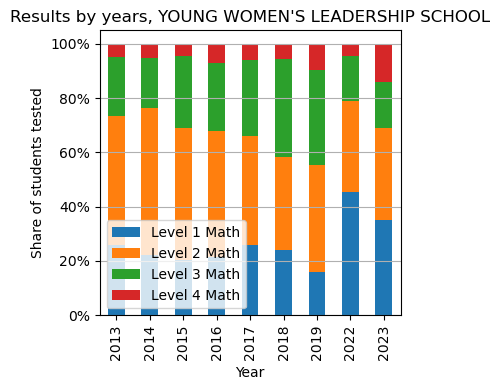

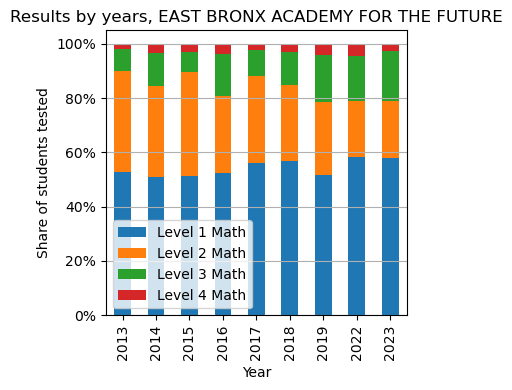

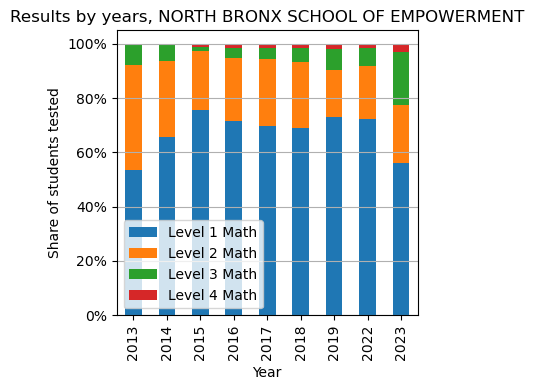

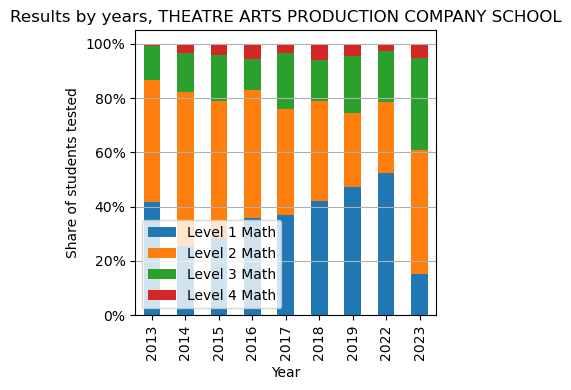

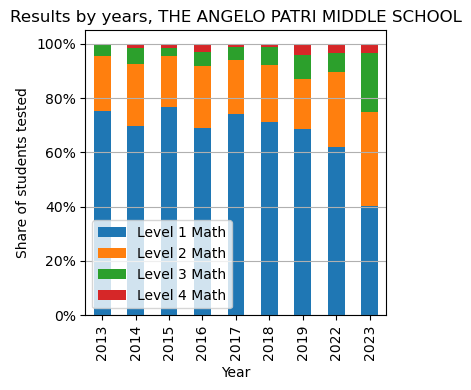

...

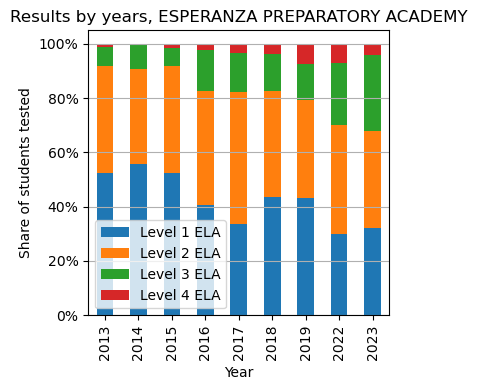

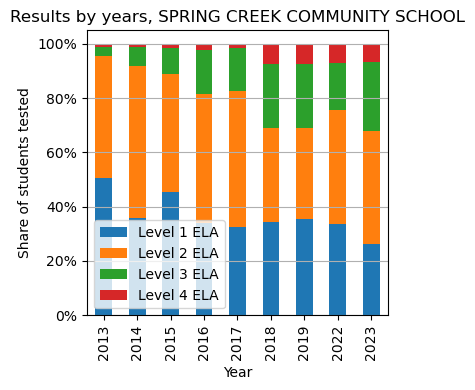

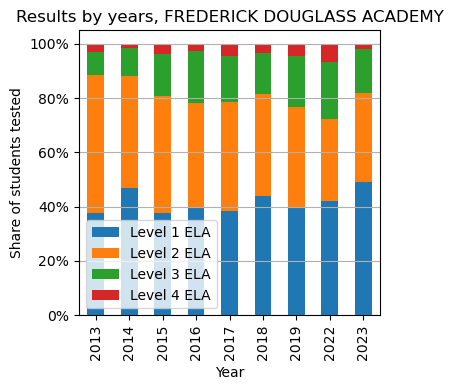

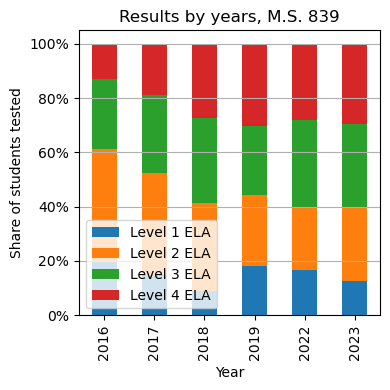

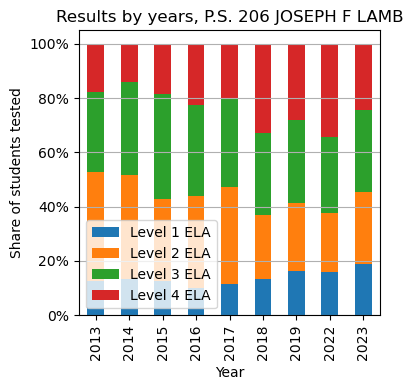

In [17]:
# Make plots for popups in the map and add them as columns to the mappable dataframe

# Function that creates a plot
def create_plot(dataframe, name):
    plot_data = dataframe.set_index('Year')[columns_to_plot]
    plot_data.plot(kind='bar', stacked=True, figsize=(4,4))
    title = 'Results by years, ' + name
    plt.title(title)  # Set the title
    plt.xlabel('Year')  # X-axis label
    plt.ylabel('Share of students tested')  # Y-axis label
    plt.grid(axis='y')
    plt.legend(loc='lower left')
    plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0], ['0%', '20%', '40%', '60%', '80%', '100%'])  # Adjust y-ticks to percentage
    plt.tight_layout()
    # Return the figure object for further use
    return plt.gcf()  # gcf - Get Current Figure

# Initialize AVGDF_mappable_plots with the original DataFrame to preserve its content across merges
AVGDF_mappable_plots = allResultsAVG2013_23_mappable.copy()

# list of schools names

schoolsNames = allResultsAVG2013_23_mappable['School Name'].to_list()
testResults = allResultsDF

# Create disctionnary to hold the dataframes by schools
schoolDFs = {}

# Make dataframes by schools 
for name in schoolsNames:
    dfName = name
    schoolDFs[dfName] = testResults[testResults['School Name_x'] == name]

plots = []
plotsDFs = {}

for subject in subjects:
    columns_to_plot = [f"Level 1 {subject}", f"Level 2 {subject}", f"Level 3 {subject}", f"Level 4 {subject}"]  
    # Plot dataframes by school
    for schoolDF, current_dataframe in schoolDFs.items():
        # schoolDF contains the name of the dataframe
        # current_dataframe contains the dataframe itself

            # Do something with current_dataframe
            # Create a plot
            fig = create_plot(current_dataframe, schoolDF)

            # Convert the plot to a PNG image and then encode it
            io_buf = BytesIO()
            fig.savefig(io_buf, format='png')
            io_buf.seek(0)
            base64_string = base64.b64encode(io_buf.read()).decode('utf8')

            pair = (schoolDF, base64_string)

            plots.append(pair)

    # add the plots to the geodataframe of middle schools subject results 
    plotsDF = pd.DataFrame(plots, columns=['School Name_x', f'plot {subject}'])

    plotsDFs[subject] = plotsDF
            
for subject, df in plotsDFs.items():
    AVGDF_mappable_plots = pd.merge(AVGDF_mappable_plots, df, left_on = 'School Name', right_on='School Name_x')

In [18]:
fname = 'AVG_tests_plots.geojson'
fpath = os.path.join(basePath, outputFolder, fname)
AVGDF_mappable_plots.to_file(fpath, driver="GeoJSON")

del fname, fpath

In [19]:
AVGDF_mappable_plots.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1004 entries, 0 to 1003
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   OBJECTID          1004 non-null   int64   
 1   LEGAL_NAME        1004 non-null   object  
 2   PHYSADDRLINE1     1004 non-null   object  
 3   PHYSCITY          1004 non-null   object  
 4   COUNTY_DESC       1004 non-null   object  
 5   RECORD_TYPE_DESC  1004 non-null   object  
 6   SDL_DESC          1004 non-null   object  
 7   geometry          1004 non-null   geometry
 8   DBN               1004 non-null   object  
 9   School Name       1004 non-null   object  
 10  Level 1 Math      970 non-null    float64 
 11  Level 2 Math      970 non-null    float64 
 12  Level 3 Math      970 non-null    float64 
 13  Level 4 Math      970 non-null    float64 
 14  Level 1 ELA       970 non-null    float64 
 15  Level 2 ELA       970 non-null    float64 
 16  Level 3 ELA     

### Preparing layer with districts

In [20]:
# Read file with district wide Math test results to add to the map
DistrictMathFile = "DistrictsMSMAthNorm.xlsx"
DistrictMathPath = os.path.join(basePath, outputFolder, DistrictMathFile)
DistrictMSMathData = pd.read_excel(DistrictMathPath)
print(DistrictMSMathData.head(5))

# Read file with district wide ELA test results to add to the map
DistrictELAFile = "DistrictsMSELANorm.xlsx"
DistrictELAPath = os.path.join(basePath, outputFolder, DistrictELAFile)
DistrictMSELAData = pd.read_excel(DistrictELAPath)
print(DistrictMSELAData.head(5))

   Unnamed: 0  Year  # Level 1  # Level 2  # Level 3  # Level 4  District
0           0  2013      0.259      0.310      0.195      0.237         1
1           1  2014      0.256      0.313      0.218      0.214         1
2           2  2015      0.235      0.330      0.206      0.229         1
3           3  2016      0.225      0.330      0.178      0.267         1
4           4  2017      0.293      0.289      0.173      0.245         1
   Unnamed: 0  Year  # Level 1  # Level 2  # Level 3  # Level 4  District
0           0  2013      0.265      0.461      0.465      0.997         1
1           1  2014      0.214      0.438      0.518      0.997         1
2           2  2015      0.216      0.397      0.537      0.997         1
3           3  2016      0.156      0.425      0.535      0.997         1
4           4  2017      0.169      0.395      0.501      0.998         1


In [21]:
# Read saved GeoJSON with average tests results and plots
AVGTestsPlotFile = 'AVG_tests_plots.geojson'
AVGTestsPlotPath = os.path.join(basePath, outputFolder,AVGTestsPlotFile)
NYCSchoolsAVGData = gpd.read_file(AVGTestsPlotPath)

In [1]:
from IPython.core.display import display, HTML

display(HTML("<style>.output_scroll { height: auto !important; max-height: 1500px; }</style>"))

# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
   
# Add dataframes with coordinates and test results to the map

def my_style(x):
    level4 = x['properties']['Level 4 Math+Ela']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*500
    }   

## Adding the layer to the map
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name = 'Percent of middle school test takers with Level 4 result',
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    name = "School districts"
).add_to(MathTestMS_map)

# folium.GeoJson(
#     NYCpublicSchoolsMath_mappable[NYCpublicSchoolsMath_mappable['Year'] == 2023],
#     marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
#     tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
#     popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
#     style_function = my_style,        
#     zoom_on_click = True,
#     name = "All middle schools"
# ).add_to(MathTestMS_map)

# Function to create iframe for a given row
def create_iframe(row):    
    html =  '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><strong>{4}:</strong> {5}<br><img src="data:image/png;base64,{6}"><br><img src="data:image/png;base64,{7}">'.format(
        'School Name', row['LEGAL_NAME'], 
        'Level 4 share Avg 2013-2023 Math', round(row['Level 4 Math'], 2), 
        'Level 4 share Avg 2013-2023 ELA', round(row['Level 4 ELA'], 2),
        row['plot Math'], row['plot ELA'])
    return folium.IFrame(html, width=500, height=450)

def create_popup(x):
    iframe = create_iframe(x)
    popup = folium.Popup(iframe)
    return popup

# Iterate over the GeoDataFrame and add a popup to each feature
for _, row in tqdm(NYCSchoolsAVGData.iterrows(), total = len(NYCSchoolsAVGData)):
    iframe = create_iframe(row)
        
    data = gpd.GeoDataFrame(row.to_frame().T, crs=NYCSchoolsAVGData.crs)
    
    folium.GeoJson(
    data,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.Popup(iframe),
    style_function = my_style, 
    control = False    
    #zoom_on_click = True,    
).add_to(MathTestMS_map)    
        
folium.LayerControl().add_to(MathTestMS_map)    
  
# # Display the map
# MathTestMS_map

# Save map to html
mfile = 'NYCMSmap.html'
mpath = os.path.join(basePath, outputFolder, mfile)
MathTestMS_map.save(mpath)

NameError: name 'folium' is not defined

In [ ]:
from IPython.core.display import display, HTML

display(HTML("<style>.output_scroll { height: auto !important; max-height: 1000px; }</style>"))

# Setting map by subject
subject = 'Math'
allSchoolsDF = resultsDFs_mappable[subject]
top50AVGDF = top50AVGDFs_mappable_plots[subject]

# Create a map object, centered at NYC
MathTestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
   
# Add dataframes with coordinates and test results to the map

def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000
    }   

# Adding the layers to the map

## School districts
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name = 'Percent of middle school test takers with Level 4 result',
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    name = "School districts"
).add_to(MathTestMS_map)

# All schoools
folium.GeoJson(
    allSchoolsDF[allSchoolsDF['Year'] == 2023],
    marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
    name = "All middle schools"
).add_to(MathTestMS_map)

# Function to create iframe for a given row
def create_iframe(row):    
    html =  '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><img src="data:image/png;base64,{4}">'.format(
        'School Name', row['LEGAL_NAME'], 
        'Level 4 share 2023', row['# Level 4'], 
        row['plot'])
    return folium.IFrame(html, width=450, height=450)

def create_popup(x):
    iframe = create_iframe(x)
    popup = folium.Popup(iframe)
    return popup

# Iterate over the GeoDataFrame and add a popup to each feature
for _, row in top50AVGDF.iterrows():
    iframe = create_iframe(row)
        
    data = gpd.GeoDataFrame(row.to_frame().T, crs=top50AVGDF.crs)
    
    folium.GeoJson(
    data,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.Popup(iframe),
    style_function = my_style, 
    control = False    
    #zoom_on_click = True,    
).add_to(MathTestMS_map)    
        
folium.LayerControl().add_to(MathTestMS_map)    
  
# Display the map
MathTestMS_map

In [ ]:
from IPython.core.display import display, HTML

display(HTML("<style>.output_scroll { height: auto !important; max-height: 1000px; }</style>"))

# Setting map by subject
subject = 'ELA'
allSchoolsDF = resultsDFs_mappable[subject]
top50AVGDF = top50AVGDFs_mappable_plots[subject]

# Create a map object, centered at NYC
ELATestMS_map = folium.Map(location=[40.6839, -73.9026], zoom_start=11, tiles="cartodb positron")
   
# Add dataframes with coordinates and test results to the map

def my_style(x):
    level4 = x['properties']['# Level 4']
    if level4 is None:
        level4 = 0
    #print(level4)
    return {
        "radius": (level4)*1000
    }   

# Adding the layers to the map

## School districts
districts = folium.Choropleth(
    geo_data = NYCDistrictsData,
    data = DistrictMSMathData[DistrictMSMathData['Year'] == 2023],
    columns = ['District','# Level 4'],
    key_on = "feature.properties.school_dist",
    fill_color = "BuPu",
    fill_opacity = 0.8,
    line_opacity=0.3,
    nan_fill_color="white",
    legend_name = 'Percent of middle school test takers with Level 4 result',
    popup = folium.GeoJsonPopup(fields=["school_dist", "Year", "# Level 1", "# Level 2", "# Level 3", "# Level 4"]), 
    name = "School districts"
).add_to(ELATestMS_map)

# All schoools
folium.GeoJson(
    allSchoolsDF[allSchoolsDF['Year'] == 2023],
    marker = folium.Circle(radius=10, fill_color='yellow', fill_opacity=1.0, color="orange", weight=0.5),
    tooltip = folium.GeoJsonTooltip(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    popup = folium.GeoJsonPopup(fields=["LEGAL_NAME","RECORD_TYPE_DESC", "# Level 4"]),
    style_function = my_style,        
    zoom_on_click = True,
    name = "All middle schools"
).add_to(ELATestMS_map)

# Function to create iframe for a given row
def create_iframe(row):    
    html =  '<strong>{0}:</strong> {1}<br><strong>{2}:</strong> {3}<br><img src="data:image/png;base64,{4}">'.format(
        'School Name', row['LEGAL_NAME'], 
        'Level 4 share 2023', row['# Level 4'], 
        row['plot'])
    return folium.IFrame(html, width=450, height=450)

def create_popup(x):
    iframe = create_iframe(x)
    popup = folium.Popup(iframe)
    return popup

# Iterate over the GeoDataFrame and add a popup to each feature
for _, row in top50AVGDF.iterrows():
    iframe = create_iframe(row)
        
    data = gpd.GeoDataFrame(row.to_frame().T, crs=top50AVGDF.crs)
    
    folium.GeoJson(
    data,
    marker = folium.Circle(radius=10, fill_color='green', fill_opacity=1.0, color="white", weight=0.5),
    popup = folium.Popup(iframe),
    style_function = my_style, 
    control = False    
    #zoom_on_click = True,    
).add_to(ELATestMS_map)    
        
folium.LayerControl().add_to(ELATestMS_map)    
  
# Display the map
ELATestMS_map

In [27]:
import re
import csv

# Lists of schools
brooklyn_schools = [
"MS 113 Ronald Edmonds Learning Center (13K113) audition or Language criteria",
"Urban Assembly Institute of Math and Science for Young Women (13K527)",
"Fort Greene Prep (13K691) Language criteria",
"Juan Morel Campos Secondary School (14K071)",
"PS/MS 84 Jose de Diego (14K084) Language criteria",
"IS 318 Eugenio Maria De Hostos (14K318)",
"Young Women’s Leadership School of Brooklyn (14K614)",
"Lyons Community School (14K586)",
"JHS 88 Peter Rouget (15K088)",
"Boerum Hill School for International Studies (15K497)",
"IS 136 Charles O. Dewey (15K136)",
"Ebbets Field (17K352)",
"Science, Technology and Research Early College HS at Erasmus (17K543) school based assessment",
"East Flatbush Community Research School (18K581)",
"IS 285 Meyer Levin (18K285) audition and open",
"Legacy School of the Arts (19K907) audition",
"JHS 218 James P. Sinnott (19K218) Language criteria",
"JHS 220 John J. Pershing (20K220)",
"Urban Assembly School for Leadership and Empowerment (20K609)",
"IS 228 David Boody (21K228) audition, talent assessment, test",
"IS 281 Joseph B. Cavallaro (21K281)",
"Eagle Academy for Young Men (23K644)",
"Kappa V (23K518)",
"IS 349 Math, Science & Tech (32K349)",
"JHS 383 Philippa Schuyler (32K383) course grades",
"JHS 291 Roland Hayes (32K291)",
"Evergreen Middle School for Urban Exploration (32K562)",
"All City Leadership Secondary School (32K554) course grades"
]

citywide_schools = [
"New Explorations into Science, Technology & Math (01M539) course grades",
"The Anderson School (03M334) course grades",
"Tag Young Scholars (04M012) course grades",
"Brooklyn School of Inquiry (20K686) course grades",
"The 30th Avenue School (30Q300) course grades",
"School for Global Leaders  (01M378)",
"The 47 American Sign Language & English Lower School (02M347)",
"Ballet Tech, NYC Public School Dance (02M442) audition",
"Ella Baker School (02M225)",
"I.C.E. Institute for Collaborative Education (02M407)",
"School of the Future Middle and High School (02M413)",
"Professional Performing Arts School (02M408) audition",
"Quest to Learn (02M422)",
"Special Music School (03M859) audition",
"MS 224 Manhattan East School for Arts & Academics (04M224)",
"J.H.S. 123 James M. Kieran  (08X123)",
"Restoration Academy Magnet School of Global Exploration and Innovation (13K301)",
"J.H.S. 050 John D. Wells  (14K050) Language criteria",
"MS 448 Brooklyn Collaborative (15K448)",
"Park Slope Collegiate  (15K464)",
"M.S. 035 Stephen Decatur  (16K035)",
"The Brooklyn Green School  (16K898)",
"Medgar Evers College Preparatory School (17K590) school based assessment",
"Lenox Academy (18K235) course grades",
"I.S. 171 Abraham Lincoln  (19K171)",
"Van Siclen Community Middle School  (19K654)",
"Mark Twain IS 239 for the Gifted & Talented (21K239) variety of school based assessments and audition depending on the program",
"I.S. 392  (23K392)",
"Scholar’s Academy (27Q323) course grades",
"Catherine & Count Basie Middle School  (28Q072)",
"Redwood Middle School  (28Q332)",
"M.S. 358  (28Q358)",
"Baccalaureate School for Global Education (30Q580) school based assessment"
]

# Function to process schools
def process_schools(school_list, open_to):
    processed_schools = []
    pattern = re.compile(r"(.+?)\s+\((\d+[KMQ]\d{3})\)(.*)")
    for school in school_list:
        match = pattern.match(school)
        if match:
            school_name = match.group(1).strip()
            dbn = match.group(2).strip()
            comments = match.group(3).strip()
            processed_schools.append([dbn, school_name, open_to, comments])
    return processed_schools

# Process both lists
processed_brooklyn = process_schools(brooklyn_schools, "Brooklyn")
processed_citywide = process_schools(citywide_schools, "Citywide")

# Combine lists
all_schools = processed_brooklyn + processed_citywide

# Write to CSV
csv_filename = "cityBoroughWideschools.csv"
csv_path = os.path.join(basePath, dataFolder, csv_filename)
with open(csv_filename, "w", newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['DBN', 'School Name', 'Open to', 'Comments']) # CSV header
    for school in all_schools:
        writer.writerow(school)

print(f"CSV file '{csv_filename}' has been created with {len(all_schools)} schools.")


CSV file 'cityBoroughWideschools.csv' has been created with 60 schools.
